# Hageldatenanalyse

In diesem Notebook ToDo: kurze Beschreibung

* [Verteilung Hageltage und Hagelkorngrösse](#hail_distribution)

* [Hagel Trends seit 2002](#hail_trends)

* [Hagelrisiko nach Monat und Kantone](#hail_canton_month)



In [19]:
! pip install plotly
! pip install folium
! pip install geopandas

In [20]:
from pathlib import Path
import pandas as pd
import numpy as np
import plotly.express as px
import folium
import geopandas as gpd
from branca.colormap import linear

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

In [21]:
processed_data_path = Path("./data/processed")
out_hail_data_file = "haildata_per_month.csv"

shape_path = Path("data") / "Swiss_shape_files"
shape_canton_file = "swissBOUNDARIES3D_1_4_TLM_KANTONSGEBIET.shp"

In [22]:
df_hail = pd.read_csv(processed_data_path / out_hail_data_file, sep=",")
df_hail.head()

,time,year,month,lat,lon,canton,haildays,hailsize
0,2002-04-01,2002,4,46.792770,7.890503,BE,0,2.0
1,2002-04-01,2002,4,46.838557,7.576278,BE,0,2.5
2,2002-04-01,2002,4,46.883549,7.563273,BE,1,4.0
3,2002-04-01,2002,4,46.883534,7.576393,BE,1,4.0
4,2002-04-01,2002,4,46.979808,8.233808,OW,0,2.0


In [23]:
sum(~df_hail[["lat", "lon"]].duplicated())

39059

In [24]:
sum(~df_hail[["lat", "lon", "canton"]].duplicated())

39059

In [25]:
df_hail["lat_lon"] = df_hail["lat"].astype(str) + "_" + df_hail["lon"].astype(str)

In [26]:
points_per_canton = df_hail.groupby("canton")["lat_lon"].nunique()
points_per_canton

canton
AG    1381
AI     129
AR     278
BE    5988
BL     545
BS      19
FR    1583
GE     238
GL     599
GR    6543
JU     728
LU    1504
NE     890
NW     266
OW     689
SG    1972
SH     231
SO     779
SZ     968
TG     926
TI    2505
UR     852
VD    3010
VS    4565
ZG     198
ZH    1673
Name: lat_lon, dtype: int64

In [27]:
points_per_canton.sum()

39059

<a id="hail_distribution"></a>
## Verteilung Hageltage und Hagelkorngrösse
# WIP

In [29]:
df_haildays_sum = df_hail.groupby(["lat", "lon"]).agg(
    haildays_sum = ("haildays", "sum"),
    haildays_mean = ("haildays", "mean"),
).reset_index()
df_test.head()

,lat,lon,haildays_sum,haildays_mean
0,45.828893,9.027811,26,0.928571
1,45.829075,9.014946,21,0.875000
2,45.829255,9.002082,28,0.965517
3,45.837887,9.028072,30,0.967742
4,45.838068,9.015206,27,0.964286


In [30]:
latitudes = df_haildays_sum.lat
longitudes = df_haildays_sum.lon
strengths = df_haildays_sum.haildays_sum

# Load the shapefile into a GeoDataFrame
gdf = gpd.read_file(shape_path / shape_canton_file)

# Define a color map
colormap = linear.YlOrRd_09.scale(min(strengths), max(strengths))

# Create a map centered on Switzerland
switzerland_map = folium.Map(location=[46.8182, 8.2275], zoom_start=8)

# Add Switzerland"s borders to the map using a GeoJSON file
folium.GeoJson(
    gdf.to_json(),
    name="geojson"
).add_to(switzerland_map)

# Add circle markers for each location
for lat, lon, strength in zip(latitudes, longitudes, strengths):
    folium.CircleMarker(
        location=[lat, lon],
        radius=2,
        fill=True,
        fill_opacity=0.7,
        color=None,
        fill_color=colormap(strength),
    ).add_to(switzerland_map)

# Add colorbar legend (sum of hail days from 2002-2022)
colormap.caption = "Sum of Hail Days"
colormap.add_to(switzerland_map)

# Add layer control
folium.LayerControl().add_to(switzerland_map)

# Display the map
switzerland_map

In [31]:
df_hail_canton = df_hail.groupby(["year", "canton"]).agg(
    haildays_sum = ("haildays", "sum"),
    haildays_mean = ("haildays", "mean"),
).reset_index()
df_hail_canton.head()

,year,canton,haildays_sum,haildays_mean
0,2002,AG,842,1.268072
1,2002,AI,98,1.661017
2,2002,AR,550,1.334951
3,2002,BE,2757,1.071512
4,2002,BL,820,1.287284


In [32]:
points_per_canton = points_per_canton.reset_index()
points_per_canton.head()

,canton,lat_lon
0,AG,1381
1,AI,129
2,AR,278
3,BE,5988
4,BL,545


In [33]:
df_hail_canton = df_hail_canton.merge(points_per_canton[["canton", "lat_lon"]], left_on="canton", right_on="canton")
df_hail_canton.head()

,year,canton,haildays_sum,haildays_mean,lat_lon
0,2002,AG,842,1.268072,1381
1,2003,AG,847,1.044390,1381
2,2004,AG,1000,1.166861,1381
3,2005,AG,924,1.233645,1381
4,2006,AG,1772,1.429032,1381


In [34]:
df_hail_canton["hail_per_point"] = df_hail_canton.haildays_sum / df_hail_canton.lat_lon

In [39]:
# read the shapefile of Swiss cantons into a GeoDataFrame
canton_map = gpd.read_file(shape_path / shape_canton_file)

cantons = {
    "Zürich": "ZH",
    "Bern": "BE",
    "Luzern": "LU",
    "Uri": "UR",
    "Schwyz": "SZ",
    "Obwalden": "OW",
    "Nidwalden": "NW",
    "Glarus": "GL",
    "Zug": "ZG",
    "Fribourg": "FR",
    "Solothurn": "SO",
    "Basel-Stadt": "BS",
    "Basel-Landschaft": "BL",
    "Schaffhausen": "SH",
    "Appenzell Ausserrhoden": "AR",
    "Appenzell Innerrhoden": "AI",
    "St. Gallen": "SG",
    "Graubünden": "GR",
    "Aargau": "AG",
    "Thurgau": "TG",
    "Ticino": "TI",
    "Vaud": "VD",
    "Valais": "VS",
    "Neuchâtel": "NE",
    "Genève": "GE",
    "Jura": "JU"
}

canton_map = canton_map.replace({"NAME":cantons})

In [41]:
# join the data with the shapefile by canton name
canton_data = canton_map.merge(df_hail_canton, left_on="NAME", right_on="canton")

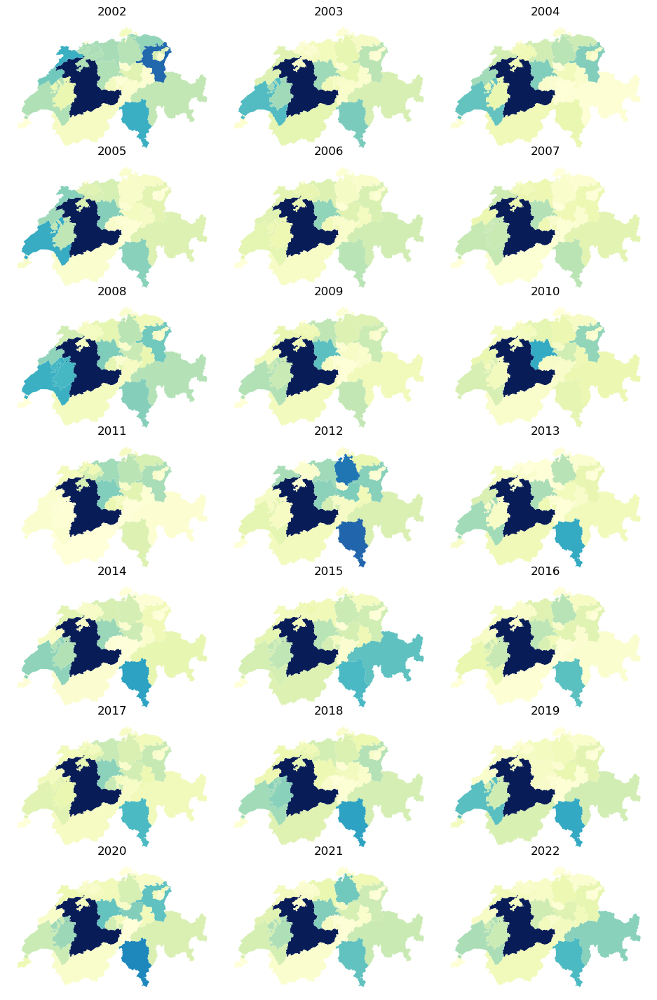

In [43]:
fig = plt.figure(figsize=(18, 18))
grid = ImageGrid(fig, 111, nrows_ncols=(7, 3), axes_pad=0.1)

for i, year in enumerate(df_hail_canton["year"].unique()):
    year_data = canton_data[canton_data["year"]==year]
    ax = grid[i]
    ax.axis("off")
    ax.set_title(str(year))
    year_data.plot(
        ax=ax, 
        column="haildays_sum",
        cmap="YlGnBu",
        linewidth=0.1,
        legend=False,
        legend_kwds={"label": "Sum of hail days"},
    )
plt.show()

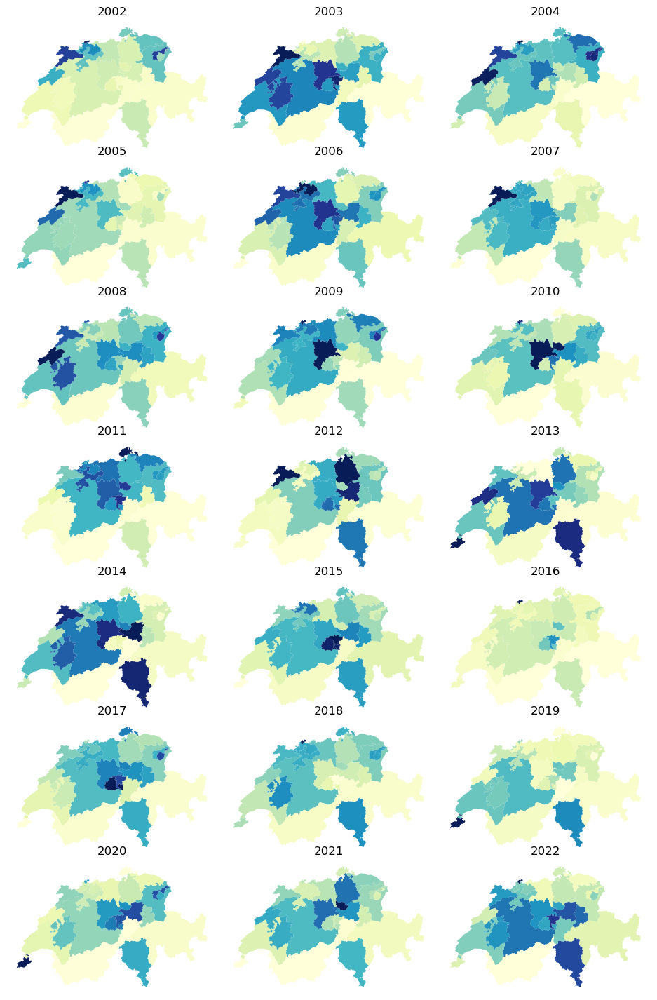

In [44]:
fig = plt.figure(figsize=(18, 18))
grid = ImageGrid(fig, 111, nrows_ncols=(7, 3), axes_pad=0.1)

for i, year in enumerate(df_hail_canton["year"].unique()):
    year_data = canton_data[canton_data["year"]==year]
    ax = grid[i]
    ax.axis("off")
    ax.set_title(str(year))
    year_data.plot(
        column="hail_per_point",
        cmap="YlGnBu",
        linewidth=0.1,
        ax=ax, 
        legend=False,
        legend_kwds={"label": "Hail per point"},
    )

plt.show()

In [46]:
df_hail_total = df_hail_canton.groupby("year").agg({"haildays_sum": sum, "lat_lon": sum}).reset_index()
df_hail_total["hail_per_point"] = df_hail_total["haildays_sum"] / df_hail_total["lat_lon"]
df_hail_total["canton"] = "All"
df_hail_total.head()

# df_test = df_test.merge(df_test_total, left_on="NAME", right_on="year")

,year,haildays_sum,lat_lon,hail_per_point,canton
0,2002,17773,39059,0.455030,All
1,2003,40382,39059,1.033872,All
2,2004,20723,39059,0.530556,All
3,2005,21459,39059,0.549400,All
4,2006,38243,39059,0.979109,All


In [48]:
df_hail_total.head()

,year,haildays_sum,lat_lon,hail_per_point,canton
0,2002,17773,39059,0.455030,All
1,2003,40382,39059,1.033872,All
2,2004,20723,39059,0.530556,All
3,2005,21459,39059,0.549400,All
4,2006,38243,39059,0.979109,All


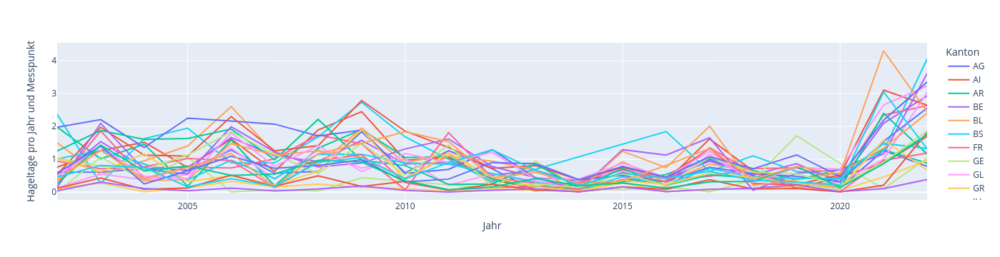

In [56]:
fig = px.line(df_hail_canton, x="year", y="hail_per_point", color="canton")

fig.update_layout(
    # title="Plot Title",
    xaxis_title="Jahr",
    yaxis_title="Hageltage pro Jahr und Messpunkt",
    legend_title="Kanton",
    # font=dict(
    #     family="Arial",
    #     size=18,
    #     color="RebeccaPurple"
    # )
)
fig.show()

In [54]:
df_hail_canton

,year,canton,haildays_sum,haildays_mean,lat_lon,hail_per_point
0,2002,AG,842,1.268072,1381,0.609703
1,2003,AG,847,1.044390,1381,0.613324
2,2004,AG,1000,1.166861,1381,0.724113
3,2005,AG,924,1.233645,1381,0.669080
4,2006,AG,1772,1.429032,1381,1.283128
...,...,...,...,...,...,...
536,2018,ZH,599,1.079279,1673,0.358039
537,2019,ZH,521,1.003854,1673,0.311417
538,2020,ZH,370,1.027778,1673,0.221160
539,2021,ZH,5102,0.508269,1673,3.049611


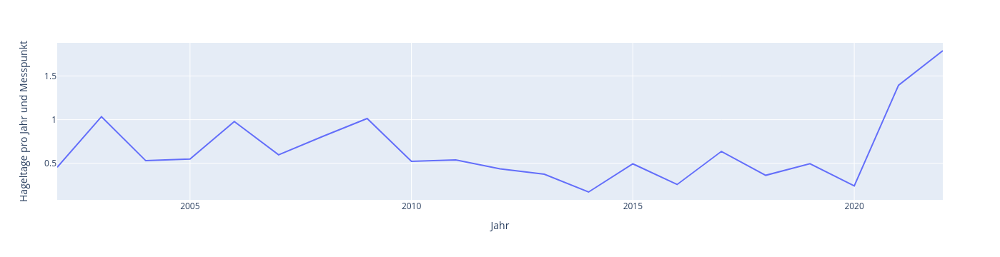

In [55]:
fig = px.line(df_hail_total, x="year", y="hail_per_point")#, color="canton")

fig.update_layout(
    # title="Plot Title",
    xaxis_title="Jahr",
    yaxis_title="Hageltage pro Jahr und Messpunkt",
    legend_title="Kanton",
    # font=dict(
    #     family="Arial",
    #     size=18,
    #     color="RebeccaPurple"
    # )
)
fig.show()